<a href="https://colab.research.google.com/github/laume/smart_crop/blob/master/smart_crop_w_losses.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

![alt text](https://lustorageacc.blob.core.windows.net/lu-container-01/all.png)

# Smart image crop

The inspiration to create Smart Image Crop came from using `GetPet` application https://www.getpet.lt/. 

Some dog profile images while opening it - was cropped not nicely, thats why I decided to create smart crop app.


I used the dataset from `kaggle` with labeled cat and dog head possitions:
https://www.kaggle.com/devdgohil/the-oxfordiiit-pet-dataset 

The main task was to predict dog or cat face possition and crop its image by using these data.

First task was to get square images.
Later this model can be extended to get other image ratios.


# Environment Setup

In [44]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [0]:
SETUP = True
COMPETITION = 'kaggle datasets download -d devdgohil/the-oxfordiiit-pet-dataset'

In [0]:
import os

try:
    %tensorflow_version 2.x
    %matplotlib inline
except:
    %load_ext lab_black
    os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
    os.environ["CUDA_VISIBLE_DEVICES"] = "0"

In [5]:
if SETUP:
    !pip install -q -U dlai
    !pip install -q -U toai
    !pip install -q -U nb_black

    print(__import__("toai").__version__)
    print(f'dlai version: {__import__("dlai").__version__}, tf version: {__import__("tensorflow").__version__}')

     |████████████████████████████████| 296kB 9.6MB/s 
     |████████████████████████████████| 81kB 9.9MB/s 
     |████████████████████████████████| 153kB 49.1MB/s 
     |████████████████████████████████| 552kB 50.1MB/s 
     |████████████████████████████████| 102kB 12.2MB/s 
     |████████████████████████████████| 61kB 8.2MB/s 
     |████████████████████████████████| 747kB 44.5MB/s 
0.5.3
dlai version: 0.0.17, tf version: 2.2.0-rc3


The main helper fuctions used in this project are imported from `utils_multi_labels.py` file.

In [0]:
if SETUP:
    !cp '/content/gdrive/My Drive/get_pet/utils_multi_labels.py' .

In [0]:
%load_ext autoreload
%autoreload 2

In [0]:
import dlai
from dlai.imports import *
import tensorflow as tf
from tensorflow import keras
from toai.imports import *
from toai.image import ImageAugmentor, ImageParser, ImageResizer, ImageDataContainer
from toai.data.utils import split_df
from toai.encode import CategoricalEncoder
from typing import *
import tensorflow as tf
from tensorflow import keras
import tensorflow_datasets as tfds
import tensorflow_hub as hub
from glob import glob
from matplotlib.patches import Rectangle, Circle
from skimage.transform import resize
from utils_multi_labels import *

In [0]:
DATA_DIR = Path('data/')
PROJECT_DIR = Path('/content/gdrive/My Drive/smart_crop/')
TEST_DIR = Path('test_data/')

In [0]:
if SETUP:
    setup_kaggle()
    download_kaggle_data(COMPETITION, DATA_DIR)

In [52]:
!ls {DATA_DIR}/annotations/annotations

list.txt  README  test.txt  trainval.txt  trimaps  xmls


# Data Preprocessing

### Create dataframe from Image and XML files

In [0]:
df = files_to_df(DATA_DIR /'images/', 'jpg')

In [54]:
df.head()

,filename,ids
0,data/images/images/german_shorthaired_199.jpg,german_shorthaired_199.jpg
1,data/images/images/pomeranian_164.jpg,pomeranian_164.jpg
2,data/images/images/scottish_terrier_156.jpg,scottish_terrier_156.jpg
3,data/images/images/beagle_124.jpg,beagle_124.jpg
4,data/images/images/pomeranian_76.jpg,pomeranian_76.jpg


In [55]:
len(df)

7390

In [56]:
df.describe()

,filename,ids
count,7390,7390
unique,7390,7390
top,data/images/images/Ragdoll_152.jpg,pug_81.jpg
freq,1,1


In [57]:
!cat 'data/annotations/annotations/xmls/Bengal_177.xml'

<annotation><folder>OXIIIT</folder><filename>Bengal_177.jpg</filename><source><database>OXFORD-IIIT Pet Dataset</database><annotation>OXIIIT</annotation><image>flickr</image></source><size><width>225</width><height>300</height><depth>3</depth></size><segmented>0</segmented><object><name>cat</name><pose>Frontal</pose><truncated>0</truncated><occluded>0</occluded><bndbox><xmin>67</xmin><ymin>110</ymin><xmax>113</xmax><ymax>157</ymax></bndbox><difficult>0</difficult></object></annotation>


In [0]:
df_anno = parse_xml_to_df(str(DATA_DIR / "annotations/annotations/xmls"))

In [59]:
df_anno.sample(5).T

,1787,2649,30,1273,1854
filename,basset_hound_118.jpg,Abyssinian_176.jpg,keeshond_175.jpg,basset_hound_15.jpg,newfoundland_142.jpg
name,dog,cat,dog,dog,dog
pose,Frontal,Frontal,Frontal,Frontal,Frontal
width,500,400,500,500,500
height,332,467,375,332,375
depth,3,3,3,3,3
xmin,106,65,269,45,88
ymin,11,16,72,3,73
xmax,406,243,372,205,233
ymax,331,175,218,160,202


In [60]:
len(df_anno), len(df)

(3686, 7390)

In [61]:
!find "data/annotations/annotations/xmls/" -type f | wc -l

3686


In [62]:
!find "data/images/images/" -type f | wc -l

7393


In [63]:
df_anno.describe().T

,count,unique,top,freq
filename,3686,3686,shiba_inu_196.jpg,1
name,3686,2,dog,2498
pose,3686,1,Frontal,3686
width,3686,292,500,2011
height,3686,319,500,938
depth,3686,1,3,3686
xmin,3686,364,1,52
ymin,3686,242,1,269
xmax,3686,429,319,27
ymax,3686,393,231,28


In [64]:
data = df.merge(df_anno, left_on='ids', right_on='filename')
data.sample(3).T

,3364,3031,311
filename_x,data/images/images/boxer_155.jpg,data/images/images/Ragdoll_101.jpg,data/images/images/boxer_122.jpg
ids,boxer_155.jpg,Ragdoll_101.jpg,boxer_122.jpg
filename_y,boxer_155.jpg,Ragdoll_101.jpg,boxer_122.jpg
name,dog,cat,dog
pose,Frontal,Frontal,Frontal
width,500,333,500
height,333,500,333
depth,3,3,3
xmin,4,73,273
ymin,1,37,142


In [65]:
data.name.nunique(), len(data)

(2, 3686)

In [66]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3686 entries, 0 to 3685
Data columns (total 12 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   filename_x  3686 non-null   object
 1   ids         3686 non-null   object
 2   filename_y  3686 non-null   object
 3   name        3686 non-null   object
 4   pose        3686 non-null   object
 5   width       3686 non-null   object
 6   height      3686 non-null   object
 7   depth       3686 non-null   object
 8   xmin        3686 non-null   object
 9   ymin        3686 non-null   object
 10  xmax        3686 non-null   object
 11  ymax        3686 non-null   object
dtypes: object(12)
memory usage: 374.4+ KB


In [0]:
data = data.astype({
    'width': 'int32', 
    'height': 'int32', 
    'depth': 'int32', 
    'xmin': 'int32', 
    'ymin': 'int32', 
    'xmax': 'int32', 
    'ymax': 'int32',
    })

In [68]:
data.dtypes

filename_x    object
ids           object
filename_y    object
name          object
pose          object
width          int32
height         int32
depth          int32
xmin           int32
ymin           int32
xmax           int32
ymax           int32
dtype: object

In [0]:
%matplotlib inline

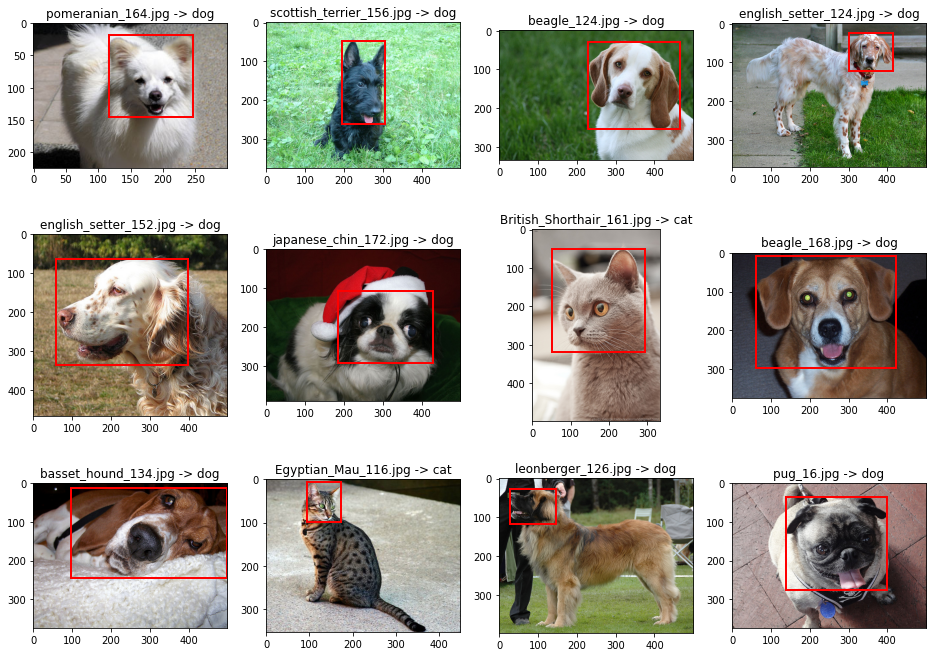

In [70]:
plot_real_df_images_bbox(data, 12)

In [0]:
data = add_bbox_ratio(data)

In [72]:
data.sample(3).T

,1675,3157,3331
filename_x,data/images/images/Bengal_157.jpg,data/images/images/beagle_105.jpg,data/images/images/scottish_terrier_180.jpg
ids,Bengal_157.jpg,beagle_105.jpg,scottish_terrier_180.jpg
filename_y,Bengal_157.jpg,beagle_105.jpg,scottish_terrier_180.jpg
name,cat,dog,dog
pose,Frontal,Frontal,Frontal
width,262,500,424
height,246,395,500
depth,3,3,3
xmin,0.10687,0.636,0.162736
ymin,0.113821,0.301266,0.386


In [73]:
category_map = {i: v for i, v in enumerate(sorted(data.name.unique()))}
category_map

{0: 'cat', 1: 'dog'}

In [0]:
data['category'] = 0
data.loc[data.name == 'dog', 'category'] = 1

In [75]:
data[['name', 'category']].sample(10).T

,2269,3029,2664,1308,2826,2193,2452,1093,2011,3308
name,dog,dog,cat,cat,dog,cat,dog,cat,dog,dog
category,1,1,0,0,1,0,1,0,1,1


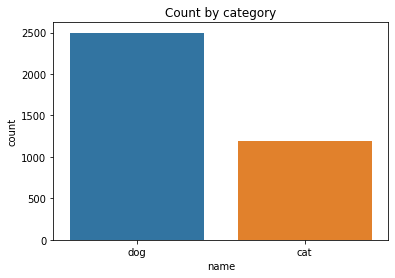

In [76]:
sns.countplot(x='name', data=data);
plt.title('Count by category');

## Preparing the dataset

The main Model setup parameters 

In [0]:
BATCH_SIZE = 16
SHUFFLE_SIZE = 1024
IMG_DIMS = (299, 299, 3)
N_IMAGES = data.shape[0]
N_CLASSES = data['name'].nunique()

Data split:
```
80 % for training set
10 % for validation set
10 % for testing set
```

In [0]:
train_data, validation_data, test_data = split_df(data, 0.2, "category", random_state=13)

In [79]:
train_data.category.value_counts()

1    1998
0     950
Name: category, dtype: int64

In [80]:
validation_data.category.value_counts()

1    250
0    119
Name: category, dtype: int64

In [81]:
test_data.category.value_counts()

1    250
0    119
Name: category, dtype: int64

In [0]:
train_set = (
    tf.data.Dataset.from_tensor_slices(
        (
            train_data["filename_x"],
            tuple(
                [
                    train_data["category"].values,
                    train_data[["xmin", "ymin", "object_width", "object_height"]].values,
                ]
            ),
        )
    )
    .map(ImageParser(), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .map(ImageResizer(IMG_DIMS, "stretch"), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .map(ImageAugmentor(level=3, rotate=False), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .repeat()
    .shuffle(SHUFFLE_SIZE)
    .batch(BATCH_SIZE)
    .prefetch(tf.data.experimental.AUTOTUNE)
)

In [0]:
validation_set = (
    tf.data.Dataset.from_tensor_slices(
        (
            validation_data["filename_x"],
            tuple(
                [
                    validation_data["category"].values,
                    validation_data[
                        ["xmin", "ymin", "object_width", "object_height"]
                    ].values,
                ]
            ),
        )
    )
    .map(ImageParser(), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .map(ImageResizer(IMG_DIMS, "stretch"), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .batch(BATCH_SIZE)
    .prefetch(tf.data.experimental.AUTOTUNE)
)

In [0]:
test_set = (
    tf.data.Dataset.from_tensor_slices(
        (
            test_data["filename_x"],
            tuple(
                [
                    test_data["category"].values,
                    test_data[["xmin", "ymin", "object_width", "object_height"]].values,
                ]
            ),
        )
    )
    .map(ImageParser(), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .map(ImageResizer(IMG_DIMS, "stretch"), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .batch(BATCH_SIZE)
    .prefetch(tf.data.experimental.AUTOTUNE)
)

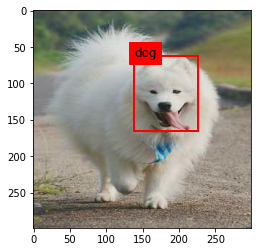

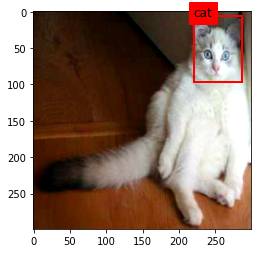

In [85]:
plot_tf_dataset_images(train_set, 2, IMG_DIMS, category_map)

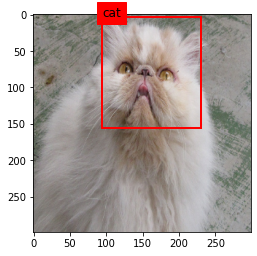

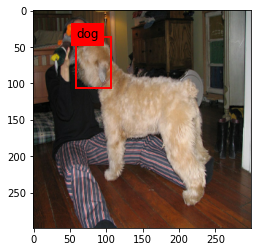

In [86]:
plot_tf_dataset_images(validation_set, 2, IMG_DIMS, category_map)

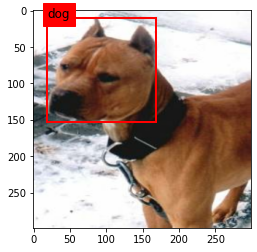

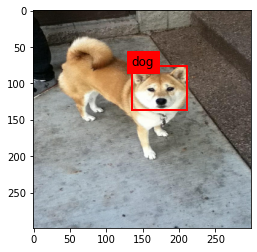

In [87]:
plot_tf_dataset_images(test_set, 2, IMG_DIMS, category_map)

# Xception model with custom loss functions for bounding box predictions

**Define custom Cost function:**

The function `add_bbox_ratio()` scales coordinates and obj length/width which makes them vary from 0..1, and makes independent from image resolution.

Then we can define cost function as simple average difference of all four parameters `[xmin, ymin, obj_width, obj_height]`. 
Therefore our Cost functions will also have a range 0 .. 1.

Loss function's equiation:

```(|Xmin_pred - Xmin_gt| + |Ymin_pred - Ymin_gt| + |OBJ_WIDTH_pred - OBJ_WIDTH_gt| + |OBJ_HEIGHT_pred - OBJ_HEIGHT_gt|) / 4```

In [0]:
class AvgDifference(tf.keras.losses.Loss):
    def __call__(self, y_true, y_pred, sample_weight=None):
        return tf.reduce_mean(
            tf.divide(
                tf.reduce_sum(tf.abs(tf.subtract(y_pred, y_true)), axis=1), 
                tf.broadcast_to(
                    tf.cast(tf.shape(y_true)[1], dtype=tf.float32), 
                    tf.shape(y_true)[:1]
                )
            )
        )


**Mine Cost Function:**

I decided to use Intersection over Union as a Cost function for bounding box predictions, because when I did the project before, I used that function for final model evaluation. 

In [0]:
class IoU(keras.losses.Loss):
    def __call__(self, y_true, y_pred, sample_weight=None):
        x_t = y_true[..., 0]
        y_t = y_true[..., 1]
        w_t = y_true[..., 2]
        h_t = y_true[..., 3]

        x_p = y_pred[..., 0]
        y_p = y_pred[..., 1]
        w_p = y_pred[..., 2]
        h_p = y_pred[..., 3]

        w_intersection = tf.maximum(tf.minimum(tf.add(x_t, w_t), tf.add(x_p, w_p)) - tf.maximum(x_t, x_p), 0.)
        h_intersection = tf.maximum(tf.minimum(tf.add(y_t, h_t), tf.add(y_p, h_p)) - tf.maximum(y_t, y_p), 0.)

        I = tf.multiply(w_intersection, h_intersection)
        U = tf.subtract(tf.add(tf.multiply(w_t, h_t), tf.multiply(w_p, h_p)), I)
        iou_value = tf.math.divide_no_nan(I, U)
        
        return tf.reduce_mean(tf.subtract(1., iou_value))


I've added `GlobalConcatPooling2D` layer to keep more features info.

In [0]:
class GlobalConcatPooling2D(keras.layers.Layer):
    def __call__(self, layer: keras.layers.Layer) -> keras.layers.Layer:
        return keras.layers.concatenate(
            [
                keras.layers.GlobalAvgPool2D()(layer),
                keras.layers.GlobalMaxPool2D()(layer),
            ]
        )

Previously for the project was used `BinaryCrossentropy` cost function.

Now I had two runs: 

1. with `AvgDifference` cost function
2. with `IoU` cost function

I used the same hyperparameters for easier results comparison. 

In [0]:
def make_model(dropout, lr, loss_cat, loss_bounding):
    base = keras.applications.Xception(
        input_shape=IMG_DIMS, include_top=False, weights="imagenet"
    )
    x = GlobalConcatPooling2D()(base.output)
    x = keras.layers.Dropout(dropout)(x)
    category = keras.layers.Dense(N_CLASSES, activation=keras.activations.softmax, name="catgr")(x)
    bounding_box = keras.layers.Dense(4, activation=keras.activations.sigmoid, name="bbox")(x)
    model = keras.Model(inputs=base.input, outputs=[category, bounding_box])
    model.compile(
        loss=[
            keras.losses.SparseCategoricalCrossentropy(),
            # keras.losses.BinaryCrossentropy(),
            # IoU(),
            AvgDifference(),
        ],
        loss_weights=[loss_cat, loss_bounding],
        optimizer=keras.optimizers.Adam(lr),
    )
    return model

In [0]:
model = make_model(0.4, 1e-4, 0.5, 2.0)

In [0]:
# model.summary()

### Fit for 20 epochs and check predictions

In [122]:
history = model.fit(
    x=train_set,
    validation_data=validation_set,
    steps_per_epoch=math.ceil(train_data.shape[0] / BATCH_SIZE),
    epochs=5,
    callbacks=[
        keras.callbacks.ModelCheckpoint(
            str(PROJECT_DIR / "model1_xception_w_avgdiff.h5"), save_best_only=True, save_weights_only=True
        ),
        keras.callbacks.ReduceLROnPlateau(factor=0.3, patience=1),
        keras.callbacks.EarlyStopping(patience=3, restore_best_weights=True),
    ],
)

Epoch 1/5
185/185 [==============================] - 244s 1s/step - loss: 0.3326 - catgr_loss: 0.0977 - bbox_loss: 0.1418 - val_loss: 0.2098 - val_catgr_loss: 0.0037 - val_bbox_loss: 0.1040 - lr: 1.0000e-04
Epoch 2/5
185/185 [==============================] - 247s 1s/step - loss: 0.1823 - catgr_loss: 0.0234 - bbox_loss: 0.0853 - val_loss: 0.1449 - val_catgr_loss: 0.0054 - val_bbox_loss: 0.0711 - lr: 1.0000e-04
Epoch 3/5
185/185 [==============================] - 245s 1s/step - loss: 0.1401 - catgr_loss: 0.0141 - bbox_loss: 0.0665 - val_loss: 0.1064 - val_catgr_loss: 0.0063 - val_bbox_loss: 0.0516 - lr: 1.0000e-04
Epoch 4/5
185/185 [==============================] - 246s 1s/step - loss: 0.1160 - catgr_loss: 0.0122 - bbox_loss: 0.0549 - val_loss: 0.0954 - val_catgr_loss: 0.0035 - val_bbox_loss: 0.0468 - lr: 1.0000e-04
Epoch 5/5
185/185 [==============================] - 246s 1s/step - loss: 0.1050 - catgr_loss: 0.0145 - bbox_loss: 0.0489 - val_loss: 0.0861 - val_catgr_loss: 0.0105 - val_

In [0]:
# Run with Xception model and [SparseCategoricalCrossentropy(), IoU()] losses
# Epoch 1/5
# 185/185 [==============================] - 230s 1s/step - loss: 1.4642 - catgr_loss: 0.1290 - bbox_loss: 0.6999 - val_loss: 1.2653 - val_catgr_loss: 0.0183 - val_bbox_loss: 0.6280 - lr: 1.0000e-04
# Epoch 2/5
# 185/185 [==============================] - 229s 1s/step - loss: 1.1060 - catgr_loss: 0.0656 - bbox_loss: 0.5366 - val_loss: 1.0384 - val_catgr_loss: 0.0212 - val_bbox_loss: 0.5139 - lr: 1.0000e-04
# Epoch 3/5
# 185/185 [==============================] - 229s 1s/step - loss: 0.9627 - catgr_loss: 0.0533 - bbox_loss: 0.4680 - val_loss: 0.7948 - val_catgr_loss: 0.0120 - val_bbox_loss: 0.3944 - lr: 1.0000e-04
# Epoch 4/5
# 185/185 [==============================] - 228s 1s/step - loss: 0.8174 - catgr_loss: 0.0379 - bbox_loss: 0.3992 - val_loss: 0.6789 - val_catgr_loss: 0.0146 - val_bbox_loss: 0.3358 - lr: 1.0000e-04
# Epoch 5/5
# 185/185 [==============================] - 227s 1s/step - loss: 0.7525 - catgr_loss: 0.0332 - bbox_loss: 0.3680 - val_loss: 0.6208 - val_catgr_loss: 0.0111 - val_bbox_loss: 0.3076 - lr: 1.0000e-04

In [0]:
# Old run with Xception model and [SparseCategoricalCrossentropy(), BinaryCrossentropy()] losses
# Train for 93 steps, validate for 12 steps
# Epoch 1/5
# 93/93 [==============================] - 83s 896ms/step - loss: 1.3370 - dense_loss: 0.1257 - dense_1_loss: 0.6371 - val_loss: 1.1787 - val_dense_loss: 0.0088 - val_dense_1_loss: 0.5871
# Epoch 2/5
# 93/93 [==============================] - 68s 736ms/step - loss: 1.1529 - dense_loss: 0.0200 - dense_1_loss: 0.5714 - val_loss: 1.1314 - val_dense_loss: 0.0097 - val_dense_1_loss: 0.5633
# Epoch 3/5
# 93/93 [==============================] - 68s 733ms/step - loss: 1.1291 - dense_loss: 0.0113 - dense_1_loss: 0.5617 - val_loss: 1.1142 - val_dense_loss: 0.0068 - val_dense_1_loss: 0.5554
# Epoch 4/5
# 93/93 [==============================] - 68s 734ms/step - loss: 1.1164 - dense_loss: 0.0129 - dense_1_loss: 0.5550 - val_loss: 1.1053 - val_dense_loss: 0.0076 - val_dense_1_loss: 0.5508
# Epoch 5/5
# 93/93 [==============================] - 68s 732ms/step - loss: 1.1040 - dense_loss: 0.0063 - dense_1_loss: 0.5504 - val_loss: 1.0979 - val_dense_loss: 0.0050 - val_dense_1_loss: 0.5477
# <tensorflow.python.keras.callbacks.History at 0x7f3a4b0acf60>

In [0]:
# model.load_weights(str(PROJECT_DIR / "model1_xception_w_iou.h5"))
model.load_weights(str(PROJECT_DIR / "model1_xception_w_avgdiff.h5"))

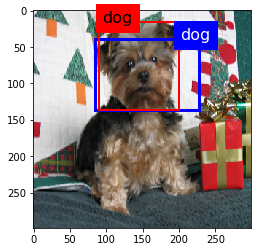

In [0]:
# old prediction:
# predict(model, validation_set, 8)

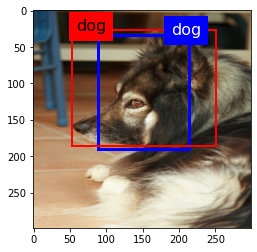

In [54]:
# IoU prediction:
# predict_one(model, validation_set, IMG_DIMS, category_map, 12)

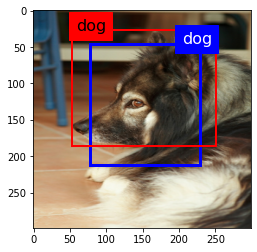

In [123]:
# AvgDifference prediction:
predict_one(model, validation_set, IMG_DIMS, category_map, 12)

### Plot activations

In [0]:
def show_activation_maps(model, dataset, activation_layer_name, category_map, cols: int = 4):
    activation_map_model = keras.Model(
        inputs=model.input, outputs=model.get_layer(activation_layer_name).output
    )

    images, (labels, _) = next(iter(dataset))
    activation_maps = activation_map_model.predict(images)
    class_probs, _ = model.predict(images)
    predictions = class_probs.argmax(-1)

    rows = math.ceil(len(images) / cols)

    _, ax = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    for i, (image, label, activation_map, prediction) in enumerate(
        zip(images, labels, activation_maps, predictions)
    ):
        weights = model.layers[-2].get_weights()[0][:, prediction]
        weights1 = weights[..., :2048]
        weights2 = weights[..., 2048:]
        weights = weights1 + weights2
        class_activation_map = resize(
            activation_map.dot(weights), IMG_DIMS[:2], order=1
        )
        idx = (i // cols, i % cols) if rows > 1 else i % cols
        ax[idx].axis("off")
        ax[idx].imshow(image, alpha=0.8)
        ax[idx].imshow(class_activation_map, cmap="jet", alpha=0.5)

        ax[idx].set_title(get_category_name(label.numpy(), category_map))

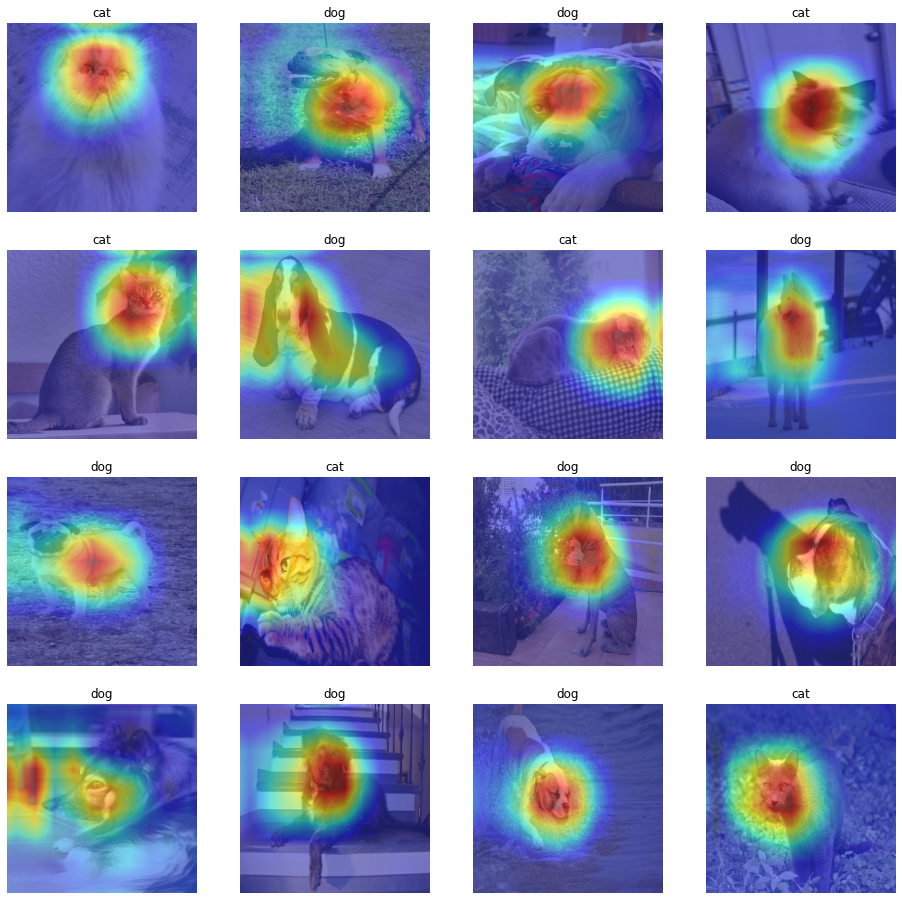

In [60]:
# global_average_pooling + global_max_pooling
show_activation_maps(model, validation_set, "block14_sepconv2_act", category_map)

### Analyse categorical predictions

In [124]:
make_report(model, validation_set, category_map)

              precision    recall  f1-score   support

         cat       0.99      1.00      1.00       119
         dog       1.00      1.00      1.00       250

    accuracy                           1.00       369
   macro avg       1.00      1.00      1.00       369
weighted avg       1.00      1.00      1.00       369



In [0]:
# IoU report 
#               precision    recall  f1-score   support

#          cat       1.00      1.00      1.00       119
#          dog       1.00      1.00      1.00       250

#     accuracy                           1.00       369
#    macro avg       1.00      1.00      1.00       369
# weighted avg       1.00      1.00      1.00       369

In [0]:
analyse_dataset(model, validation_set)

,image,label,pred,label_probs,pred_probs
0,"[[[0.2143485, 0.69434065, 0.7840908], [0.20299...",0,0,0.999723,0.999723
1,"[[[0.0008750725, 0.013957899, 0.049252022], [0...",1,1,0.999550,0.999550
2,"[[[0.75304615, 0.7645605, 0.7416546], [0.74523...",0,0,0.999555,0.999555
3,"[[[0.42565054, 0.4819034, 0.54725194], [0.4036...",0,0,0.999038,0.999038
4,"[[[0.73865616, 0.73865616, 0.7334493], [0.7068...",1,1,0.999252,0.999252
...,...,...,...,...,...
364,"[[[0.7748028, 0.8140185, 0.81794006], [0.76349...",1,1,0.998770,0.998770
365,"[[[0.54703516, 0.35671848, 0.16341098], [0.525...",0,0,0.998802,0.998802
366,"[[[0.09809825, 0.11378452, 0.16084334], [0.133...",0,0,0.998914,0.998914
367,"[[[0.26026267, 0.3403526, 0.38315898], [0.2647...",0,0,0.997447,0.997447


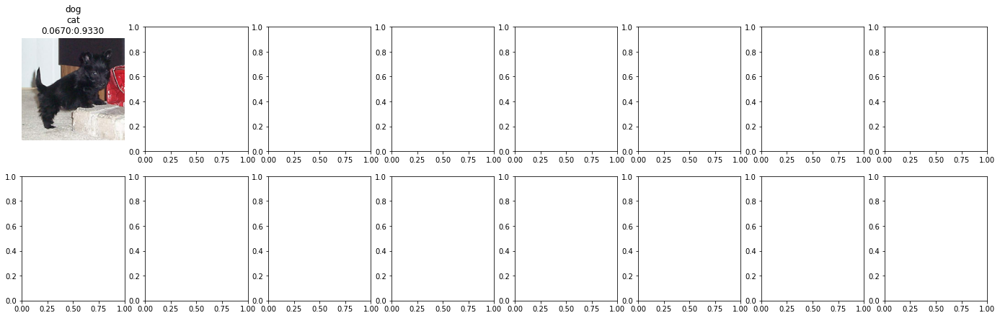

In [126]:
# with AvgDiff
show_categorical_predictions(model, validation_set, category_map)

In [137]:
model.load_weights(str(PROJECT_DIR / "model1_xception_w_iou.h5"))
# # with IoU
show_categorical_predictions(model, validation_set, category_map)

'Nothing to show! 100% accuracy!'

**100% categorical accuracy**:

 'Cat' or 'Dog' predictions for Xception model with pretrained weights is quite easy task. Nothing surprising :)

### Show model

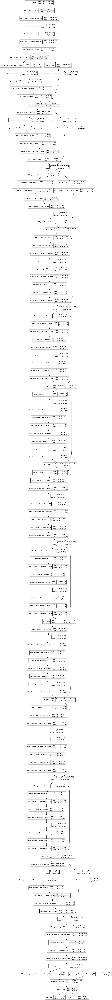

In [0]:
# keras.utils.plot_model(model,show_shapes=True)

### Train for more epochs (15)

In [127]:
history = model.fit(
    x=train_set,
    validation_data=validation_set,
    steps_per_epoch=math.ceil(train_data.shape[0] / BATCH_SIZE),
    epochs=15,
    callbacks=[
        keras.callbacks.ModelCheckpoint(
            str(PROJECT_DIR / "model1_xception_w_avgdiff_2.h5"), save_best_only=True, save_weights_only=True
        ),
        keras.callbacks.ReduceLROnPlateau(factor=0.3, patience=1),
        keras.callbacks.EarlyStopping(patience=3, restore_best_weights=True),
    ],
)

Epoch 1/15
185/185 [==============================] - 240s 1s/step - loss: 0.0925 - catgr_loss: 0.0120 - bbox_loss: 0.0433 - val_loss: 0.0819 - val_catgr_loss: 0.0071 - val_bbox_loss: 0.0392 - lr: 1.0000e-04
Epoch 2/15
185/185 [==============================] - 240s 1s/step - loss: 0.0834 - catgr_loss: 0.0115 - bbox_loss: 0.0388 - val_loss: 0.0866 - val_catgr_loss: 0.0152 - val_bbox_loss: 0.0395 - lr: 1.0000e-04
Epoch 3/15
185/185 [==============================] - 243s 1s/step - loss: 0.0740 - catgr_loss: 0.0053 - bbox_loss: 0.0357 - val_loss: 0.0753 - val_catgr_loss: 0.0124 - val_bbox_loss: 0.0346 - lr: 3.0000e-05
Epoch 4/15
185/185 [==============================] - 244s 1s/step - loss: 0.0686 - catgr_loss: 0.0041 - bbox_loss: 0.0333 - val_loss: 0.0719 - val_catgr_loss: 0.0102 - val_bbox_loss: 0.0334 - lr: 3.0000e-05
Epoch 5/15
185/185 [==============================] - 242s 1s/step - loss: 0.0665 - catgr_loss: 0.0045 - bbox_loss: 0.0321 - val_loss: 0.0739 - val_catgr_loss: 0.0139 -

In [0]:
# IoU training:
# Epoch 1/15
# 185/185 [==============================] - 240s 1s/step - loss: 0.6850 - catgr_loss: 0.0269 - bbox_loss: 0.3358 - val_loss: 0.5813 - val_catgr_loss: 0.0183 - val_bbox_loss: 0.2861 - lr: 1.0000e-04
# Epoch 2/15
# 185/185 [==============================] - 239s 1s/step - loss: 0.6442 - catgr_loss: 0.0297 - bbox_loss: 0.3147 - val_loss: 0.5300 - val_catgr_loss: 0.0128 - val_bbox_loss: 0.2618 - lr: 1.0000e-04
# Epoch 3/15
# 185/185 [==============================] - 237s 1s/step - loss: 0.5973 - catgr_loss: 0.0239 - bbox_loss: 0.2927 - val_loss: 0.4917 - val_catgr_loss: 0.0143 - val_bbox_loss: 0.2423 - lr: 1.0000e-04
# Epoch 4/15
# 185/185 [==============================] - 239s 1s/step - loss: 0.5580 - catgr_loss: 0.0137 - bbox_loss: 0.2756 - val_loss: 0.4839 - val_catgr_loss: 0.0069 - val_bbox_loss: 0.2402 - lr: 1.0000e-04
# Epoch 5/15
# 185/185 [==============================] - 239s 1s/step - loss: 0.5278 - catgr_loss: 0.0178 - bbox_loss: 0.2595 - val_loss: 0.4584 - val_catgr_loss: 0.0060 - val_bbox_loss: 0.2277 - lr: 1.0000e-04
# Epoch 6/15
# 185/185 [==============================] - 238s 1s/step - loss: 0.5156 - catgr_loss: 0.0130 - bbox_loss: 0.2546 - val_loss: 0.4454 - val_catgr_loss: 0.0052 - val_bbox_loss: 0.2214 - lr: 1.0000e-04
# Epoch 7/15
# 185/185 [==============================] - 237s 1s/step - loss: 0.4946 - catgr_loss: 0.0168 - bbox_loss: 0.2431 - val_loss: 0.4185 - val_catgr_loss: 0.0072 - val_bbox_loss: 0.2074 - lr: 1.0000e-04
# Epoch 8/15
# 185/185 [==============================] - 238s 1s/step - loss: 0.4688 - catgr_loss: 0.0108 - bbox_loss: 0.2317 - val_loss: 0.4207 - val_catgr_loss: 0.0072 - val_bbox_loss: 0.2085 - lr: 1.0000e-04
# Epoch 9/15
# 185/185 [==============================] - 238s 1s/step - loss: 0.4208 - catgr_loss: 0.0098 - bbox_loss: 0.2080 - val_loss: 0.3550 - val_catgr_loss: 0.0051 - val_bbox_loss: 0.1762 - lr: 3.0000e-05
# Epoch 10/15
# 185/185 [==============================] - 238s 1s/step - loss: 0.4048 - catgr_loss: 0.0075 - bbox_loss: 0.2005 - val_loss: 0.3563 - val_catgr_loss: 0.0053 - val_bbox_loss: 0.1768 - lr: 3.0000e-05
# Epoch 11/15
# 185/185 [==============================] - 241s 1s/step - loss: 0.3810 - catgr_loss: 0.0088 - bbox_loss: 0.1883 - val_loss: 0.3418 - val_catgr_loss: 0.0055 - val_bbox_loss: 0.1695 - lr: 9.0000e-06
# Epoch 12/15
# 185/185 [==============================] - 237s 1s/step - loss: 0.3783 - catgr_loss: 0.0081 - bbox_loss: 0.1871 - val_loss: 0.3442 - val_catgr_loss: 0.0058 - val_bbox_loss: 0.1707 - lr: 9.0000e-06
# Epoch 13/15
# 185/185 [==============================] - 238s 1s/step - loss: 0.3688 - catgr_loss: 0.0088 - bbox_loss: 0.1822 - val_loss: 0.3384 - val_catgr_loss: 0.0059 - val_bbox_loss: 0.1677 - lr: 2.7000e-06
# Epoch 14/15
# 185/185 [==============================] - 239s 1s/step - loss: 0.3652 - catgr_loss: 0.0087 - bbox_loss: 0.1804 - val_loss: 0.3364 - val_catgr_loss: 0.0056 - val_bbox_loss: 0.1668 - lr: 2.7000e-06
# Epoch 15/15
# 185/185 [==============================] - 239s 1s/step - loss: 0.3623 - catgr_loss: 0.0072 - bbox_loss: 0.1794 - val_loss: 0.3358 - val_catgr_loss: 0.0056 - val_bbox_loss: 0.1665 - lr: 2.7000e-06

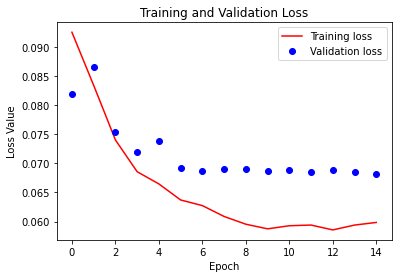

In [128]:
# AvgDiff loss:

loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(15)
plt.figure()
plt.plot(epochs,loss,'r',label='Training loss')
plt.plot(epochs,val_loss,'bo',label='Validation loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss Value')
plt.legend()
plt.show()

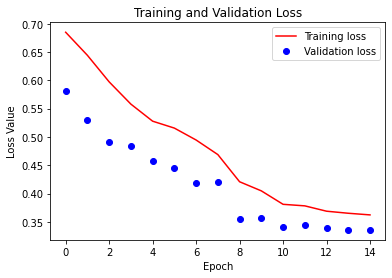

In [65]:
# IoU training loss:

# loss = history.history['loss']
# val_loss = history.history['val_loss']
# epochs = range(15)
# plt.figure()
# plt.plot(epochs,loss,'r',label='Training loss')
# plt.plot(epochs,val_loss,'bo',label='Validation loss')
# plt.title('Training and Validation Loss')
# plt.xlabel('Epoch')
# plt.ylabel('Loss Value')
# plt.legend()
# plt.show()

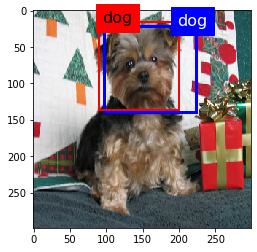

In [0]:
# Old run after 15 epochs:
# predict(model, validation_set, 8)

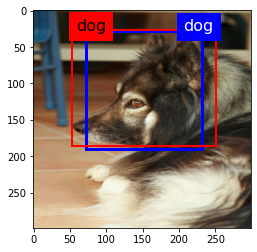

In [66]:
# IoU prediction
# predict_one(model, validation_set, IMG_DIMS, category_map, 12)

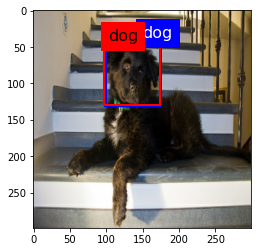

In [70]:
# IoU prediction
# predict_one(model, validation_set, IMG_DIMS, category_map, 13)

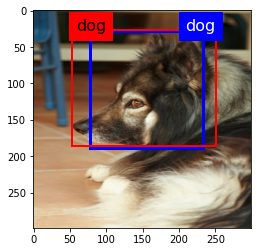

In [129]:
# AvgDiff:
predict_one(model, validation_set, IMG_DIMS, category_map, 12)

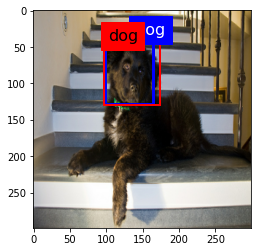

In [130]:
# AvgDiff:
predict_one(model, validation_set, IMG_DIMS, category_map, 13)

Check if categorical predictions still works well:

In [131]:
make_report(model, validation_set, category_map)

              precision    recall  f1-score   support

         cat       0.99      1.00      1.00       119
         dog       1.00      1.00      1.00       250

    accuracy                           1.00       369
   macro avg       1.00      1.00      1.00       369
weighted avg       1.00      1.00      1.00       369



In [0]:
# report for test set with IoU:
#               precision    recall  f1-score   support

#          cat       0.99      1.00      1.00       119
#          dog       1.00      1.00      1.00       250

#     accuracy                           1.00       369
#    macro avg       1.00      1.00      1.00       369
# weighted avg       1.00      1.00      1.00       369

In [0]:
# model.load_weights(str(PROJECT_DIR / "model1_xception_w_iou_2.h5"))
model.load_weights(str(PROJECT_DIR / "model1_xception_w_avgdiff_2.h5"))

Just to doubble check if model loads well:

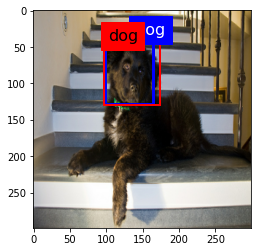

In [133]:
predict_one(model, validation_set, IMG_DIMS, category_map, 13)

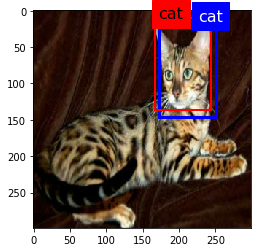

In [0]:
# old run after 20 epochs in total
# predict(model, validation_set, 20)

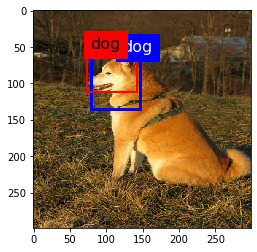

In [0]:
# old run after 20 epochs in total
# predict(model, validation_set, 23)

In [0]:
# save_model_json(str(PROJECT_DIR / 'Xception_model_1_3'), model)

# Adding Intersection over Union (IoU)

In [74]:
data.sample()

,filename_x,ids,filename_y,name,pose,width,height,depth,xmin,ymin,xmax,ymax,object_width,object_height,category
1357,data/images/images/saint_bernard_186.jpg,saint_bernard_186.jpg,saint_bernard_186.jpg,dog,Frontal,500,333,3,0.206,0.186186,0.49,0.591592,0.284,0.405405,1


In [75]:
test_data.sample()

,filename_x,ids,filename_y,name,pose,width,height,depth,xmin,ymin,xmax,ymax,object_width,object_height,category
64,data/images/images/chihuahua_122.jpg,chihuahua_122.jpg,chihuahua_122.jpg,dog,Frontal,300,225,3,0.326667,0.075556,0.71,0.604444,0.383333,0.528889,1


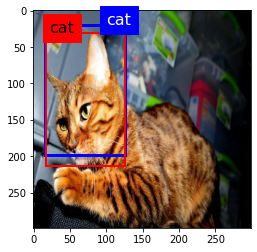

In [134]:
# With AvgDiff:
predict_one(model, validation_set, IMG_DIMS, category_map, 9)

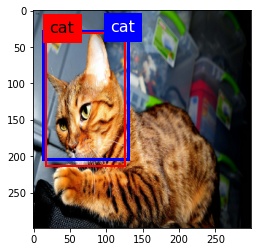

In [77]:
# With Iou
#predict_one(model, validation_set, IMG_DIMS, category_map, 9)

IoU info count    369.000000
mean       0.768918
std        0.136284
min        0.224986
25%        0.720414
50%        0.803705
75%        0.862608
max        0.970461
Name: iou, dtype: float64


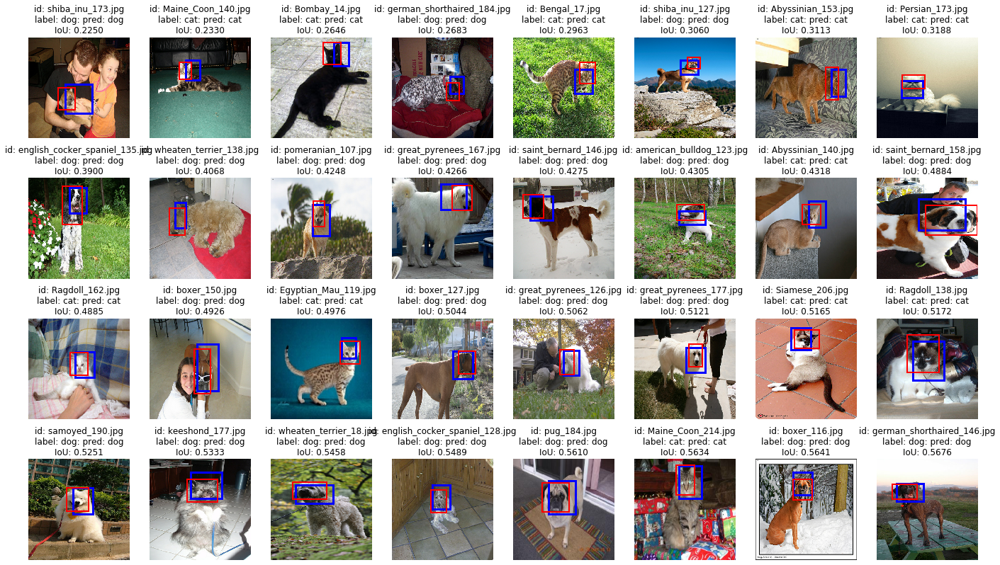

In [0]:
# Previous plot of worst predictions (Loss BinaryCrossentropy):
# show_iou(
#     model,
#     validation_set,
#     'iou',
#     validation_data,
#     category_map,
#     IMG_DIMS,
#     rows = 4,
# )

IoU info count    369.000000
mean       0.832517
std        0.086257
min        0.419364
25%        0.789951
50%        0.846738
75%        0.894176
max        0.982874
Name: iou, dtype: float64


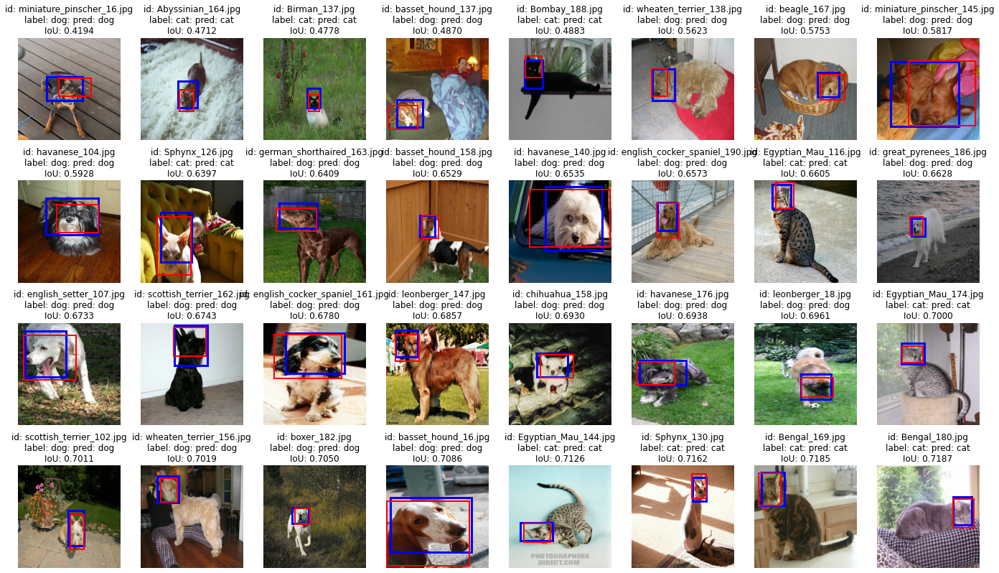

In [78]:
# IOU plot where trained with IOU loss on validation set:
# show_iou(
#     model,
#     validation_set,
#     'iou',
#     validation_data,
#     category_map,
#     IMG_DIMS,
#     rows = 4,
# )

IoU info count    369.000000
mean       0.716380
std        0.153146
min        0.018851
25%        0.656545
50%        0.749645
75%        0.810435
max        0.961403
Name: iou, dtype: float64


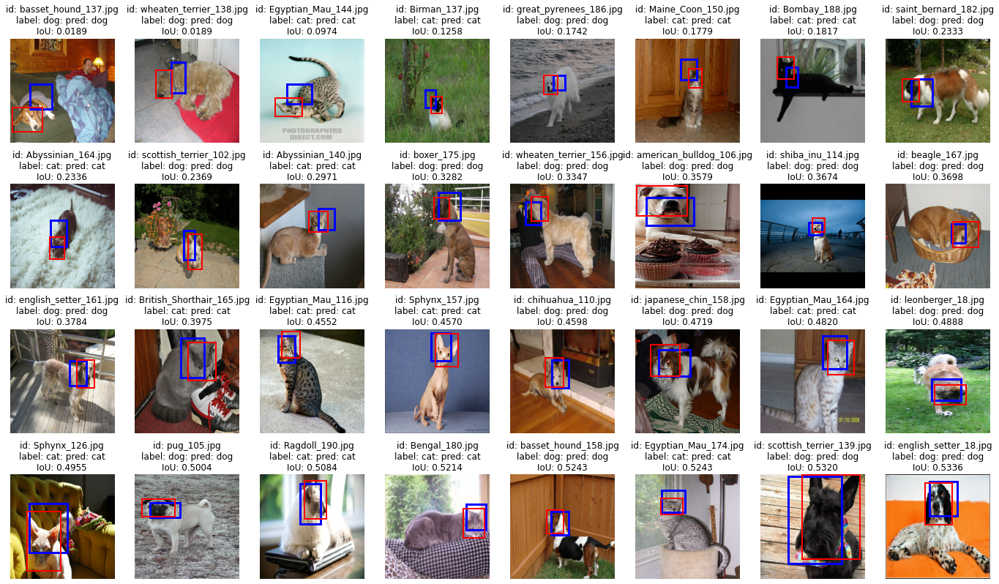

In [135]:
# IoU evaluation on model trained with AvgDiff
show_iou(
    model,
    validation_set,
    'iou',
    validation_data,
    category_map,
    IMG_DIMS,
    rows = 4,
)

**Test model performance** on `test_set` data

IoU info count    369.000000
mean       0.768665
std        0.136604
min        0.037794
25%        0.720009
50%        0.804140
75%        0.857748
max        0.949849
Name: iou, dtype: float64


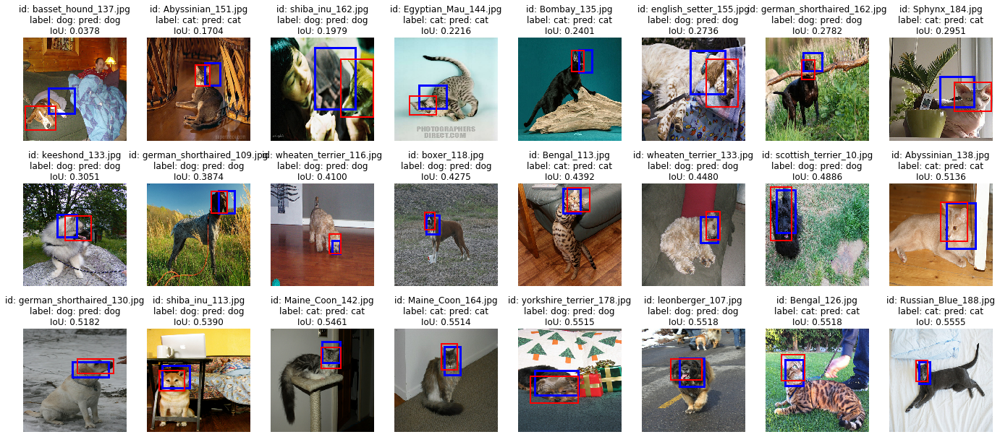

In [0]:
# Previous plot on test set, where loss was BinaryCrossentropy
# show_iou(model, test_set, 'iou', test_data, category_map, IMG_DIMS, rows = 3)

IoU info count    369.000000
mean       0.832415
std        0.095208
min        0.168151
25%        0.797369
50%        0.849745
75%        0.897436
max        0.975156
Name: iou, dtype: float64


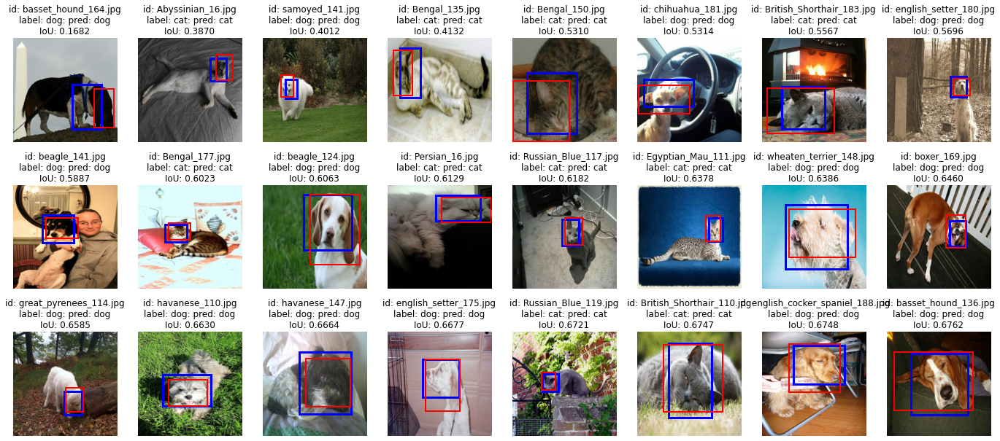

In [79]:
# Current plot on test set with IOU loss
# show_iou(model, test_set, 'iou', test_data, category_map, IMG_DIMS, rows = 3)

IoU info count    369.000000
mean       0.727550
std        0.156228
min        0.000000
25%        0.661911
50%        0.764648
75%        0.837537
max        0.969709
Name: iou, dtype: float64


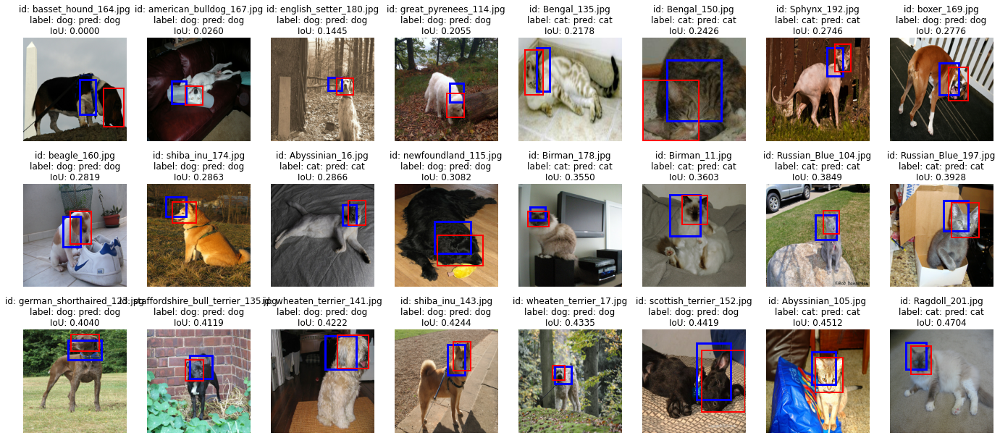

In [136]:
# With AvgDiff loss
show_iou(model, test_set, 'iou', test_data, category_map, IMG_DIMS, rows = 3)

# Conclusions on the use of different Cost functions

**Object detection model performance** 

Using 3 different Loss functions for bbox predictions gave different results for model performance:

Used loss functions:

```
BinaryCrossentropy()
IoU()
AvgDifference()
```

For performance evaluation used `IoU` metric.


Results on Test set:

```
BinaryCrossentropy:
mean       0.768665
std        0.136604
min        0.037794
25%        0.720009
50%        0.804140
75%        0.857748
max        0.949849
```
```
IoU:
mean       0.832415
std        0.095208
min        0.168151
25%        0.797369
50%        0.849745
75%        0.897436
max        0.975156
```
```
AvgDifference:
mean       0.727550
std        0.156228
min        0.000000
25%        0.661911
50%        0.764648
75%        0.837537
max        0.969709
```
By training model with AvgDifference categorical prediction gave 1 wrong prediction.
```
Category counts:
training_set   -> dogs: 1998,   cats: 950
validation_set -> dogs:  250,   cats: 119
test_set       -> dogs:  250,   cats: 119
```

## --- I endded up the custom loss function investigation here. All related code above. ---

# Test on GetPet data

In [0]:
TESTING = Path('testing/')
# SETUP = True
if SETUP:
    TESTING.mkdir(parents=True, exist_ok=True)
    !cp '/content/gdrive/My Drive/get_pet/getpet.zip' {TESTING}
    !cp '/content/gdrive/My Drive/get_pet/get_pet_annt.zip' {TESTING}
    !unzip -q -d 'testing/get_pet/' 'testing/getpet.zip'
    !unzip -q -d 'testing/get_pet_annt/' 'testing/get_pet_annt.zip'
    !rm 'testing/getpet.zip' 'testing/get_pet_annt.zip'

In [0]:
testing_df = files_to_df(TESTING/'get_pet/getpet/', 'jpg')

In [0]:
testing_df.sample(3)

,filename,ids
72,testing/get_pet/getpet/greta-photo_2g5Syax.jpg,greta-photo_2g5Syax.jpg
84,testing/get_pet/getpet/kofis-photo_Q082EA4.jpg,kofis-photo_Q082EA4.jpg
14,testing/get_pet/getpet/bolike-photo.jpg,bolike-photo.jpg


In [0]:
# ! cat {TESTING}/'get_pet_annt/get_pet_annt/69rudis-photo.xml'

In [0]:
df_anno_get_pet = parse_xml_to_df(str(TESTING/'get_pet_annt/get_pet_annt'))

In [0]:
df_anno_get_pet.sample()

,filename,name,pose,width,height,depth,xmin,ymin,xmax,ymax
92,simba-photo_xsuCyBS.jpg,dog,Unspecified,1591,2386,3,399,421,1336,1321


In [0]:
get_pet_data = testing_df.merge(df_anno_get_pet, left_on='ids', right_on='filename')
get_pet_data.sample(3).T

,103,41,9
filename_x,testing/get_pet/getpet/laki-photo.jpg,testing/get_pet/getpet/berta-photo.jpg,testing/get_pet/getpet/tvicas-photo_WSclofc.jpg
ids,laki-photo.jpg,berta-photo.jpg,tvicas-photo_WSclofc.jpg
filename_y,laki-photo.jpg,berta-photo.jpg,tvicas-photo_WSclofc.jpg
name,dog,dog,dog
pose,Unspecified,Unspecified,Unspecified
width,1994,643,1277
height,2991,965,1916
depth,3,3,3
xmin,301,6,232
ymin,206,302,262


In [0]:
get_pet_data.dtypes

filename_x    object
ids           object
filename_y    object
name          object
pose          object
width         object
height        object
depth         object
xmin          object
ymin          object
xmax          object
ymax          object
dtype: object

In [0]:
get_pet_data = get_pet_data.astype({
    'width': 'int32',
    'height': 'int32',
    'depth': 'int32',
    'xmin': 'int32',
    'ymin': 'int32',
    'xmax': 'int32',
    'ymax': 'int32',
})

In [0]:
get_pet_data.describe(include = 'all')

,filename_x,ids,filename_y,name,pose,width,height,depth,xmin,ymin,xmax,ymax
count,111,111,111,111,111,111.000000,111.000000,111.0,111.000000,111.000000,111.000000,111.000000
unique,111,111,111,1,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,testing/get_pet/getpet/pifas-photo_3mkA7Wc.jpg,garfildas-photo.jpg,garfildas-photo.jpg,dog,Unspecified,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,1,1,1,111,111,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,NaN,NaN,2000.783784,2877.459459,3.0,256.783784,433.459459,1720.216216,1812.252252
std,NaN,NaN,NaN,NaN,NaN,769.749787,1117.639987,0.0,243.539745,311.016334,701.530047,772.839669
min,NaN,NaN,NaN,NaN,NaN,641.000000,466.000000,3.0,1.000000,1.000000,484.000000,167.000000
25%,NaN,NaN,NaN,NaN,NaN,1303.500000,1947.000000,3.0,89.000000,197.000000,1045.500000,1158.500000
50%,NaN,NaN,NaN,NaN,NaN,2380.000000,3240.000000,3.0,160.000000,383.000000,1972.000000,2036.000000
75%,NaN,NaN,NaN,NaN,NaN,2592.000000,3888.000000,3.0,360.000000,600.000000,2254.000000,2385.000000


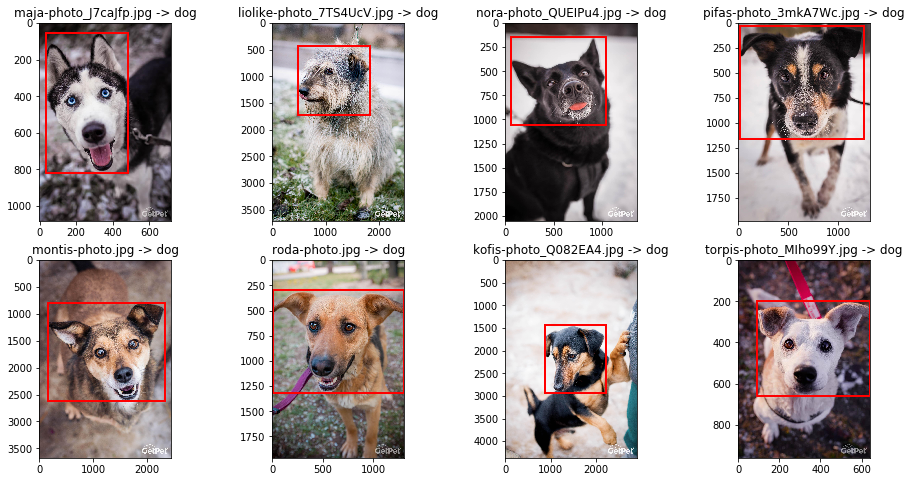

In [0]:
plot_real_df_images_bbox(get_pet_data, 8, random_plot=True)

In [0]:
get_pet_data = add_bbox_ratio(get_pet_data)

In [0]:
get_pet_data.sample()

,filename_x,ids,filename_y,name,pose,width,height,depth,xmin,ymin,xmax,ymax,object_width,object_height
106,testing/get_pet/getpet/degutis-photo.jpg,degutis-photo.jpg,degutis-photo.jpg,dog,Unspecified,2431,3646,3,0.016454,0.256445,1.0,0.679923,0.983546,0.423478


In [0]:
get_pet_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 111 entries, 0 to 110
Data columns (total 14 columns):
filename_x       111 non-null object
ids              111 non-null object
filename_y       111 non-null object
name             111 non-null object
pose             111 non-null object
width            111 non-null int32
height           111 non-null int32
depth            111 non-null int32
xmin             111 non-null float64
ymin             111 non-null float64
xmax             111 non-null float64
ymax             111 non-null float64
object_width     111 non-null float64
object_height    111 non-null float64
dtypes: float64(6), int32(3), object(5)
memory usage: 11.7+ KB


In [0]:
get_pet_data['category'] = 1
get_pet_data.loc[get_pet_data.name == 'dog', 'category'] = 0

In [0]:
get_pet_data[['name', 'category']].sample(10).T

,70,68,87,82,86,43,49,25,78,1
name,dog,dog,dog,dog,dog,dog,dog,dog,dog,dog
category,0,0,0,0,0,0,0,0,0,0


In [0]:
test_get_pet = (
    tf.data.Dataset.from_tensor_slices(
        (
            get_pet_data["filename_x"],
            tuple(
                [
                    get_pet_data["category"].values,
                    get_pet_data[
                        ["xmin", "ymin", "object_width", "object_height"]
                    ].values,
                ]
            ),
        )
    )
    .map(ImageParser(), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .map(ImageResizer(IMG_DIMS, "stretch"), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .batch(BATCH_SIZE)
    .prefetch(tf.data.experimental.AUTOTUNE)
)

IoU info count    111.000000
mean       0.770034
std        0.088793
min        0.497606
25%        0.732443
50%        0.782826
75%        0.839206
max        0.931136
Name: iou, dtype: float64


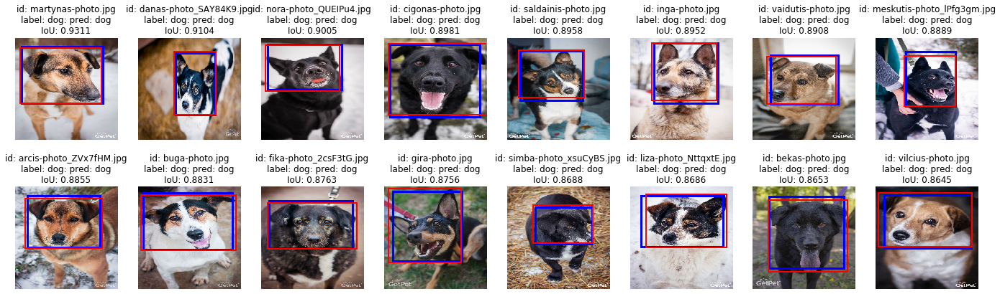

In [0]:
show_iou(
    model,
    test_get_pet,
    'iou',
    get_pet_data,
    category_map,
    IMG_DIMS,
    rows = 2,
    ascending=False,
)

IoU info count    111.000000
mean       0.770034
std        0.088793
min        0.497606
25%        0.732443
50%        0.782826
75%        0.839206
max        0.931136
Name: iou, dtype: float64


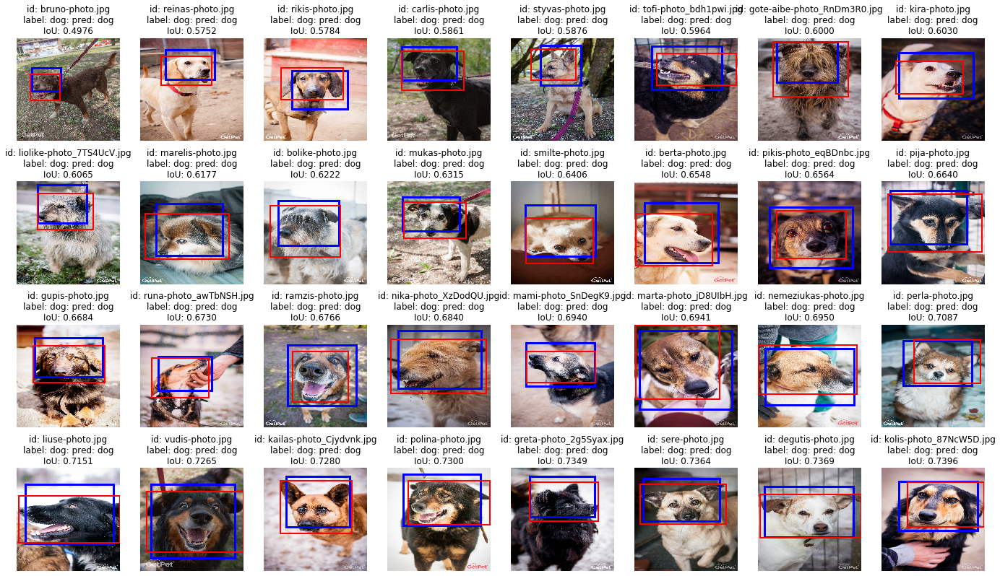

In [0]:
show_iou(
    model,
    test_get_pet,
    'iou',
    get_pet_data,
    category_map,
    IMG_DIMS,
    rows = 4,
)

### Plot boundig boxes on real size images

In [0]:
get_pet_data.sample()

,filename_x,ids,filename_y,name,pose,width,height,depth,xmin,ymin,xmax,ymax,object_width,object_height,category
20,testing/get_pet/getpet/styvas-photo.jpg,styvas-photo.jpg,styvas-photo.jpg,dog,Unspecified,1186,1779,3,0.196459,0.108488,0.631535,0.407532,0.435076,0.299044,0


In [0]:
get_pet_preds = get_pred_data(model, test_get_pet, get_pet_data)

111
111


In [0]:
get_pet_preds.sample()

,pred,pred_bbox,ids,filename_x,filename_y,name,pose,width,height,depth,xmin,ymin,xmax,ymax,object_width,object_height,category,pxmin,pymin,pw,ph
35,0,"[0.05907529, 0.13668424, 0.8805786, 0.5225276]",nemo-photo_kjWjxTX.jpg,testing/get_pet/getpet/nemo-photo_kjWjxTX.jpg,nemo-photo_kjWjxTX.jpg,dog,Unspecified,2245,3364,3,0.037862,0.192628,0.984855,0.694709,0.946993,0.502081,0,0.059075,0.136684,0.880579,0.522528


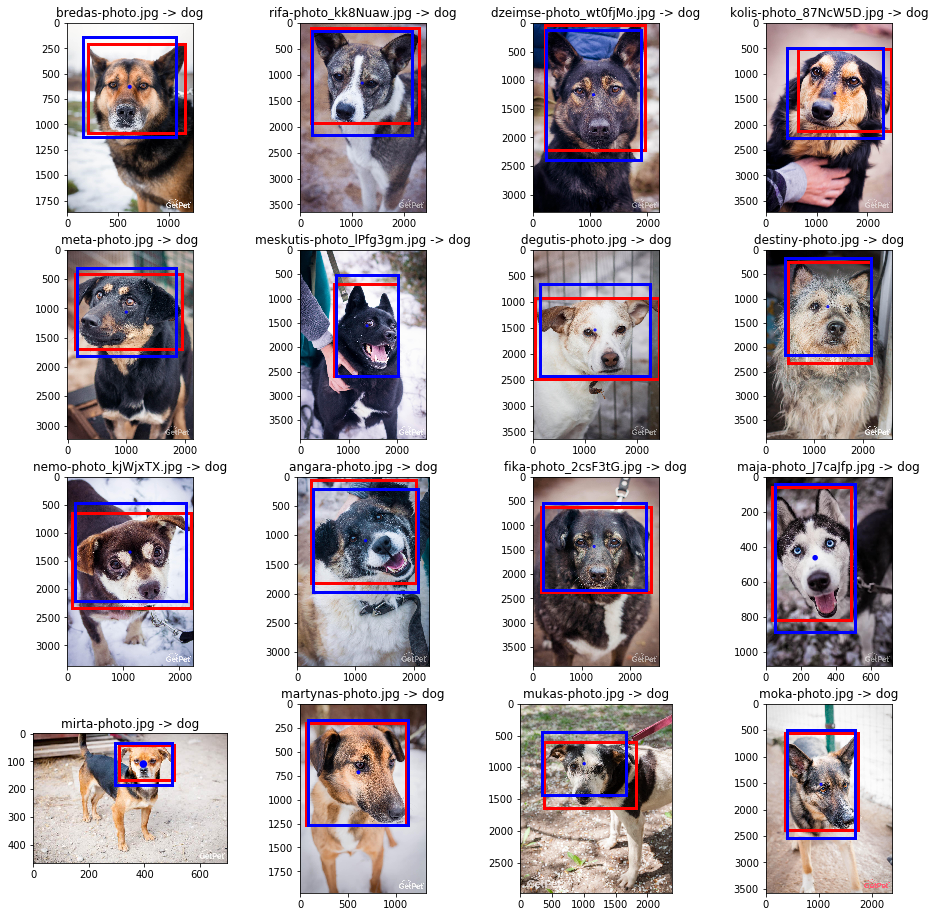

In [0]:
plot_final_df_images_bbox(
        get_pet_preds,
        16,
        random_plot=True,
    )

# Image cropping

In [0]:
if SETUP:
    !pip install -q augmentation-lib

In [0]:
import augmentation_lib

In [0]:
from augmentation_lib import center_crop_px
from augmentation_lib import resize_np

In [0]:
imgs = get_pet_preds[get_pet_preds.ids.isin([
                                            #  'montis-photo.jpg', 
                                             'bruno-photo.jpg',
                                             'danas-photo_SAY84K9.jpg',
                                             'liolike-photo_7TS4UcV.jpg',
                                             'martynas-photo.jpg', 
                                             'mirta-photo.jpg', 
                                             'angara-photo.jpg', 
                                             'destiny-photo.jpg',
                                             'meta-photo.jpg',
                                             'meskutis-photo_lPfg3gm.jpg',
                                             'kofis-photo_Q082EA4.jpg',
                                             'nagas-photo.jpg',
                                             'sirdukas-photo.jpg'
                                             ])]
imgs.sample()

,pred,pred_bbox,ids,filename_x,filename_y,name,pose,width,height,depth,xmin,ymin,xmax,ymax,object_width,object_height,category,pxmin,pymin,pw,ph
83,0,"[0.30502823, 0.20774268, 0.38014153, 0.31225756]",nagas-photo.jpg,testing/get_pet/getpet/nagas-photo.jpg,nagas-photo.jpg,dog,Unspecified,2380,2975,3,0.27437,0.219496,0.681092,0.503529,0.406723,0.284034,0,0.305028,0.207743,0.380142,0.312258


In [0]:
test_imgs = imgs.filename_x.tolist()
# test_imgs

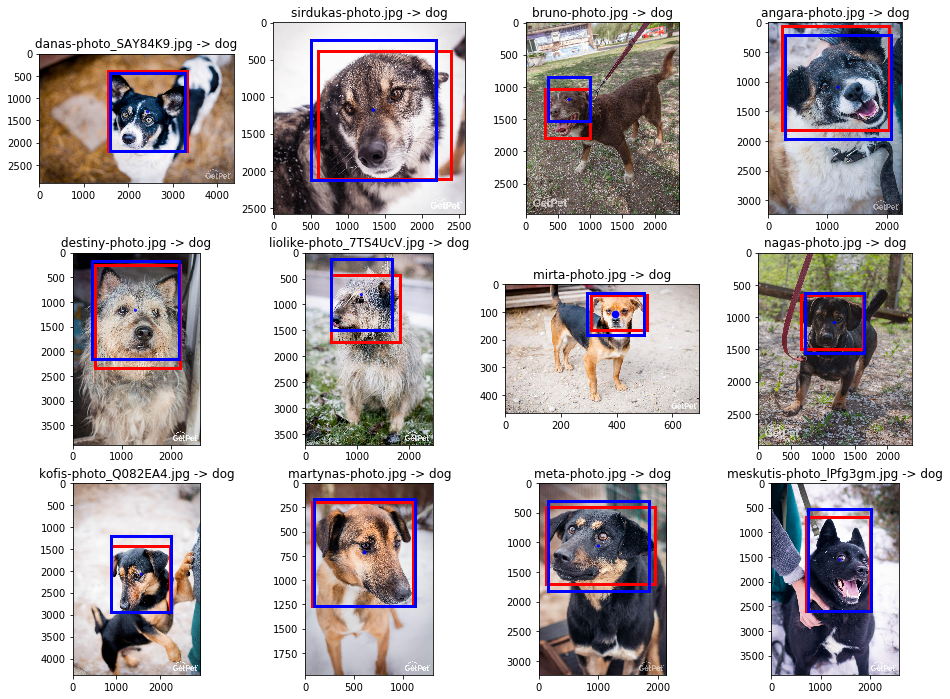

In [0]:
plot_final_df_images_bbox(imgs, len(test_imgs))

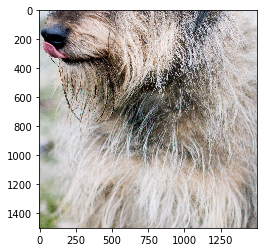

In [0]:
center_cropped_px = center_crop_px(test_imgs[4], (1500))
plt.imshow(center_cropped_px);

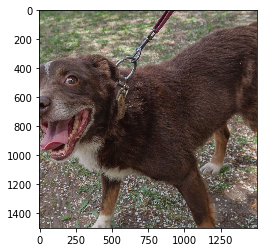

In [0]:
center_cropped_px = center_crop_px(test_imgs[2], (1500))
plt.imshow(center_cropped_px);

In [0]:
portrait_ratios = [(9, 18), (9, 16), (4, 5), (1, 1)]
landscape_ratios = [(3, 2), (4, 3), (5, 3), (16, 9)]

In [0]:
def one_img_w_ratios(img, target_ratio, img_size, bbox):
    image = plt.imread(img)
    fig, ax = plt.subplots(1)
    ax.imshow(image)
    y_rect = make_rectangle(*bbox, (img_size[0], img_size[1]), "r")
    ax.add_patch(y_rect)
    plt.show()

In [0]:
img = test_imgs[4]
target_ratio = (1, 1) # (w, h) ??
img_size = (3708, 2472)  # (h, w)
bbox = (0.197882, 0.032399, 0.479840, 0.371587)  # (x0, y0, w, h)

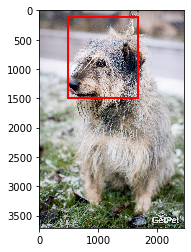

In [0]:
one_img_w_ratios(img, target_ratio, img_size, bbox)

In [0]:
def detect_img_orientation(shape: tuple) -> str:
    if not len(shape) == 2:
        'Print wrong tuple shape.'
    h, w = shape
    if h < w:
        img_pos = 'landscape'
    elif h > w:
        img_pos = 'portrait'
    else:
        img_pos = 'square'
    return img_pos

In [0]:
def bbox_crop_px(
        image: Union[str, np.ndarray], 
        target_ratio: tuple, 
        bbox: tuple,
        bbox_vs_img_ratio: Optional[float]=0.35,
        bbox_vs_pet_ratio: Optional[float]=2.,
    ) -> np.ndarray:

    if type(image) is not np.ndarray:
        img = Image.open(image)
        img_arr = np.asarray(img)
    else:
        img_arr = image

    img_size = img_arr.shape[:2]  # (h, w)
    h, w = img_size
    bbox_h, bbox_w = bbox[3] * h, bbox[2] * w
    # max_bbox = (bbox_w, bbox_h)

    img_orient = detect_img_orientation(img_size)
    limiting_size_idx = (img_size).index(min(img_size))  # h, w

    target_orient = detect_img_orientation(target_ratio)

    center_w, center_h = (
        (bbox[0] * w) + (bbox_w / 2),
        (bbox[1] * h) + (bbox_h / 2),
    )

    start_w, start_h = [0, 0]
    end_w, end_h = [w, h]

    if target_orient == 'square':

        if bbox_w > w * bbox_vs_img_ratio or bbox_h > h * bbox_vs_img_ratio:
            size = img_size[limiting_size_idx]   
            if img_orient == 'landscape' and limiting_size_idx == 0:
                start_w = max(center_w - (size / 2), 0)
                end_w = center_w + (size / 2) if start_w > 0 else size
            elif img_orient == 'portrait' and limiting_size_idx == 1:
                part_size = size / 6
                start_h = max(center_h - (part_size * 2), 0)
                end_h = center_h + (part_size * 4) if start_h > 0 else size

        else:
            size = max(bbox_h, bbox_w) * bbox_vs_pet_ratio
            part_size = size / 6
            start_w = max(center_w - (size / 2), 0)
            end_w = center_w + (size / 2) if start_w > 0 else size
            start_h = max(center_h - (part_size *2), 0)
            end_h = center_h + (part_size * 4) if start_h > 0 else size

        # plt.imshow(img_arr[int(start_h):int(end_h), int(start_w):int(end_w)])
        # plt.show()
        return img_arr[int(start_h):int(end_h), int(start_w):int(end_w)]
    else:
        print(f'{target_orient} target_ratio not supported yet! Choose (1, 1) or check again later :)')

In [0]:
bbox_crop_px(test_imgs[4], (3, 1), (0.197882, 0.032399, 0.479840, 0.371587))

portrait target_ratio not supported yet! Choose (1, 1) or check again later :)


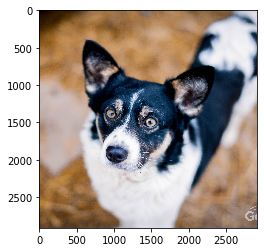

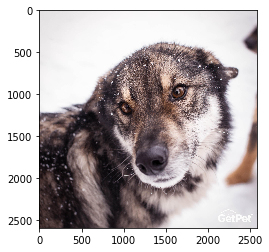

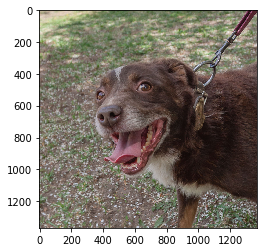

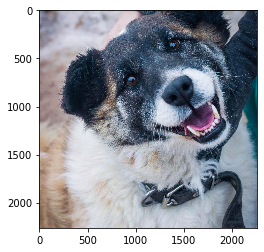

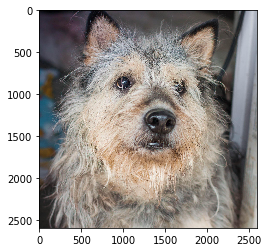

...

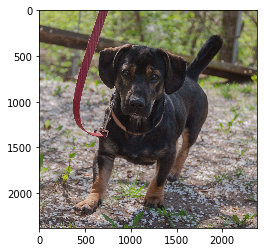

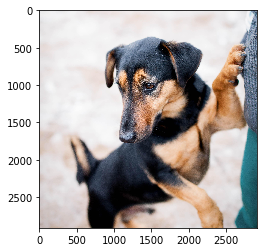

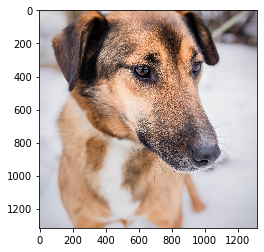

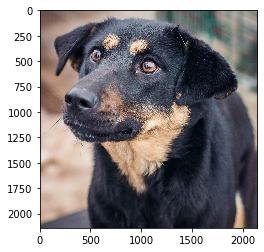

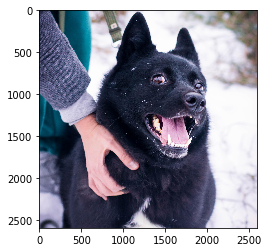

In [0]:
for row in imgs.itertuples():
    img = row.filename_x
    target_ratio = (1, 1)
    bbox = row.pred_bbox
    bbox_crop_px(img, target_ratio, bbox)

# Crop Pipeline

In [0]:
import cv2

In [0]:
model = load_model_json(
        str(PROJECT_DIR / 'Xception_model_1_3'), 
        str(PROJECT_DIR / "model1_3_xception.h5"),
    )

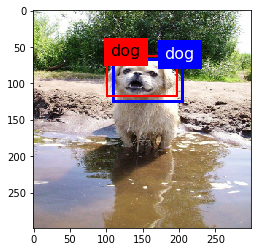

In [0]:
predict_one(model, validation_set, IMG_DIMS, category_map, 3)

In [0]:
def imgs_for_pred(
        df: pd.DataFrame, 
        path_col: str,
        img_dims: tuple, 
        batch_size: int,
    ):
    image_set = (
    tf.data.Dataset.from_tensor_slices(
        (
            df[path_col],
            tuple([]),
        )
    )
    .map(ImageParser(), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .map(ImageResizer(img_dims, "stretch"), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .batch(batch_size)
    .prefetch(tf.data.experimental.AUTOTUNE)
)
    return image_set

In [0]:
test_pipeline_df = pd.DataFrame.from_dict({'filename': [test_imgs[3], test_imgs[6]]})
# test_pipeline_df

In [0]:
PRED_SETTINGS = {
    'img_dims': (299, 299, 3),
    'batch_size': 32,
    'category_map' : {0: 'dog', 1: 'cat'},
    'model_acrh': str(PROJECT_DIR / 'Xception_model_1_3'), 
    'weights': str(PROJECT_DIR / "model1_3_xception.h5"),
}

In [0]:
def smart_crop_pipleline(
        img_df: pd.DataFrame, 
        path_col: str, 
        pred_settings: dict,
        target_ratio: Optional[tuple]=(1, 1),
        target_size: Optional[tuple]=None,
        return_df_without_crop: Optional[bool]=False,
    ) -> list:
    result = []
    model = load_model_json(
        pred_settings['model_acrh'], 
        pred_settings['weights'],
    )
    image_set = imgs_for_pred(
            img_df, 
            path_col,
            pred_settings['img_dims'],
            pred_settings['batch_size'],
        )
    prob_cat, pred_bbox = model.predict(image_set)
    pred_code = prob_cat.argmax(axis=1)
    pred_bbox_tuple = [(x) for x in pred_bbox]
    df =  pd.DataFrame.from_dict(
        {
            "pred": pred_code,
            "pred_bbox": pred_bbox_tuple,
            "filename":  img_df[path_col]
        },
    )
    if return_df_without_crop:
        return df
        
    for row in df.itertuples():
        category = get_category_name(row.pred, pred_settings['category_map'])
        cropped = bbox_crop_px(row.filename, target_ratio, row.pred_bbox)
        if target_size:
            cropped = cv2.resize(cropped, dsize=target_size, interpolation=cv2.INTER_CUBIC)
        result.append((category, cropped))

    return result

In [0]:
 res = smart_crop_pipleline(test_pipeline_df, 'filename', PRED_SETTINGS, target_size=(1500, 1500))

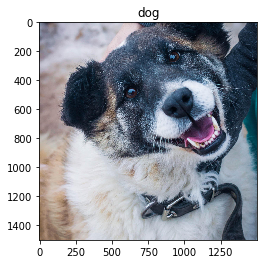

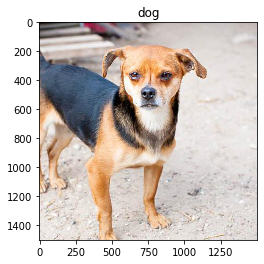

In [0]:
for x in res:
    plt.title(x[0])
    plt.imshow(x[1]) 
    plt.show()

In [0]:
PROD = Path('prod/')
SETUP = True
if SETUP:
    PROD.mkdir(parents=True, exist_ok=True)
    !cp '/content/gdrive/My Drive/get_pet/getpet_add.zip' {PROD}
    !cp '/content/gdrive/My Drive/get_pet/cats_add.zip' {PROD}
    !unzip -q -d 'prod/dogs/' 'prod/getpet_add.zip'
    !unzip -q -d 'prod/cats/' 'prod/cats_add.zip'
    !rm 'prod/getpet_add.zip' 'prod/cats_add.zip'

In [0]:
cats_df = files_to_df(PROD/'cats/cats_add/', 'jpg')
dogs_df = files_to_df(PROD/'dogs/getpet_add/', 'jpg')

In [0]:
cats_df.sample()

,filename,ids
13,prod/cats/cats_add/photo-1508710599415-734cc9b...,photo-1508710599415-734cc9b287fb.jpg


In [0]:
len(cats_df)

36

In [0]:
def plot_cropped_all(
        results: list,
        image_count: Optional[int]=1,
        random_plot: Optional[bool]=False,
    ) -> None:

    if image_count < 4:
        cols, rows = (image_count, 1)
    else:
        cols, rows = (4, math.ceil(image_count / 4))
    if len(results) < image_count:
        image_count = len(results)

    labels = []
    imgs = []
    [(labels.append(x[0]), imgs.append(x[1])) for x in results]
    df = pd.DataFrame.from_dict({
        'label': labels,
        'imgs': imgs,
    })

    if not random_plot:
        images_to_plot = df.head(image_count)
    else:
        images_to_plot = df.sample(image_count)


    _, ax = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    for i, row in enumerate(images_to_plot.itertuples()):
        idx = (i // cols, i % cols) if rows > 1 else i % cols
        ax[idx].imshow(row.imgs)
        ax[idx].set_title(row.label)

    plt.show()

In [0]:
def get_image_dims(arr):
    heights, widths = [], []
    for filename in progress_bar(arr):
        height, width, _ = np.array(keras.preprocessing.image.load_img(filename)).shape
        heights.append(height)
        widths.append(width)
    return np.asarray(heights), np.asarray(widths)

In [0]:
def plot_final_pred_bbox(
        df: pd.DataFrame,
        image_count: int,
        random_plot: Optional[bool]=False,
    ) -> None:

    if image_count < 4:
        cols, rows = (image_count, 1)
    else:
        cols, rows = (4, math.ceil(image_count / 4))
    if len(df) < image_count:
        image_count = len(df)

    if not random_plot:
        images_to_plot = df.head(image_count)
    else:
        images_to_plot = df.sample(image_count)

    df[["height", "width"]] = pd.DataFrame(get_image_dims(df["filename"])).T
    df[['xmin', 'ymin', 'w', 'h']] = pd.DataFrame(df["pred_bbox"].values.tolist(),
                                                                 index=df.index)

    _, ax = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    for i, row in enumerate(images_to_plot.itertuples()):
        idx = (i // cols, i % cols) if rows > 1 else i % cols
        img_dims = (row.height, row.width, 3)
        bounding_box = (row.xmin, row.ymin, row.w, row.h)
        y_rect = make_rectangle(*bounding_box, img_dims, "r", 3)
        ax[idx].add_patch(y_rect)
        ax[idx].imshow(plt.imread(row.filename))
        ax[idx].set_title(get_category_name(row.pred, PRED_SETTINGS['category_map']))

    plt.show()


## Check Cats

### Cat Predictions

In [0]:
%matplotlib inline

In [0]:
cat_pred_bbox = smart_crop_pipleline(cats_df, 'filename', PRED_SETTINGS, return_df_without_crop=True)

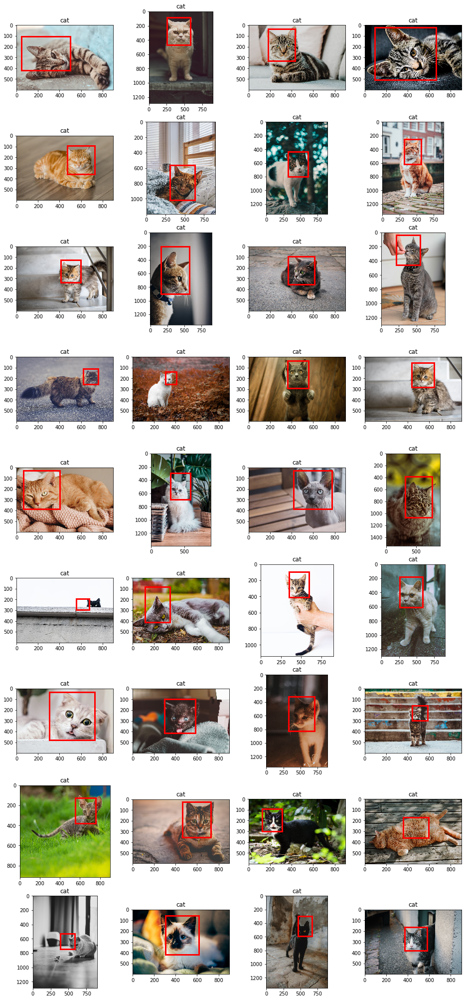

In [0]:
plot_final_pred_bbox(cat_pred_bbox, len(cat_pred_bbox))

### Cat Crops

In [0]:
res = smart_crop_pipleline(cats_df, 'filename', PRED_SETTINGS, target_size=(400, 400))

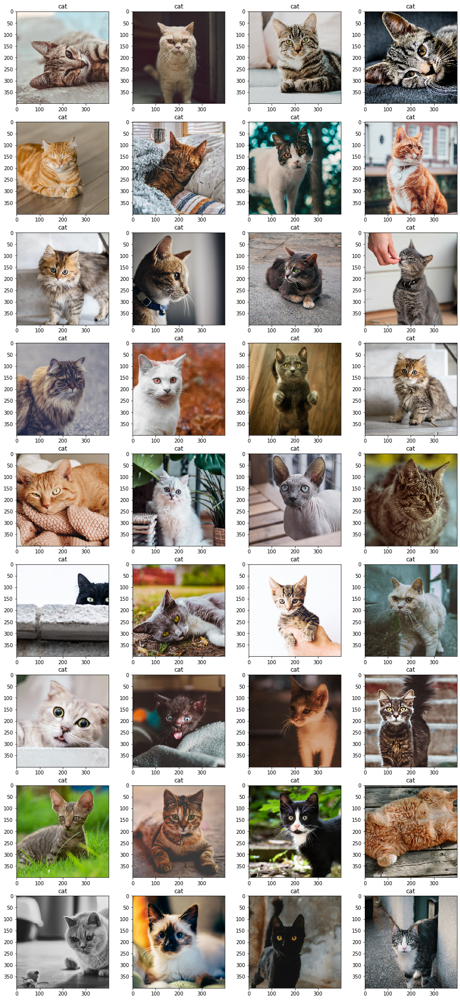

In [0]:
plot_cropped_all(res, len(res))

## Check Dogs

### Dog Predictions

In [0]:
dog_pred_bbox = smart_crop_pipleline(dogs_df, 'filename', PRED_SETTINGS, return_df_without_crop=True)

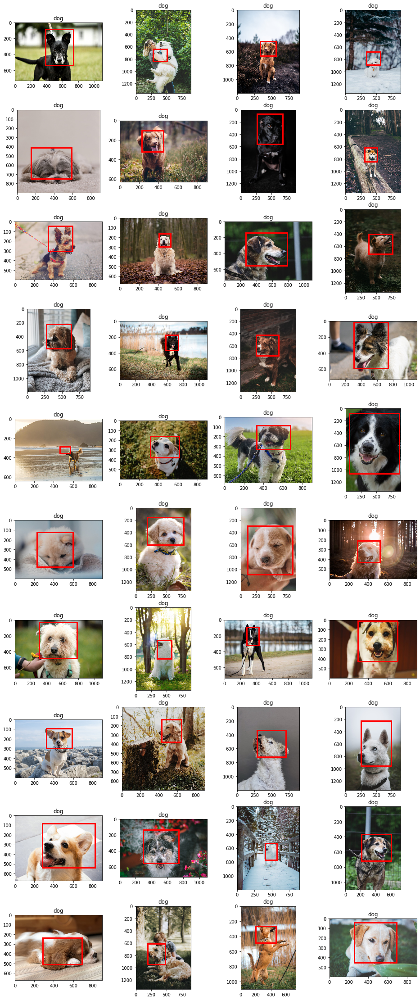

In [0]:
plot_final_pred_bbox(dog_pred_bbox, 40)

### Dog crops

In [0]:
res = smart_crop_pipleline(dogs_df, 'filename', PRED_SETTINGS, target_size=(400, 400))

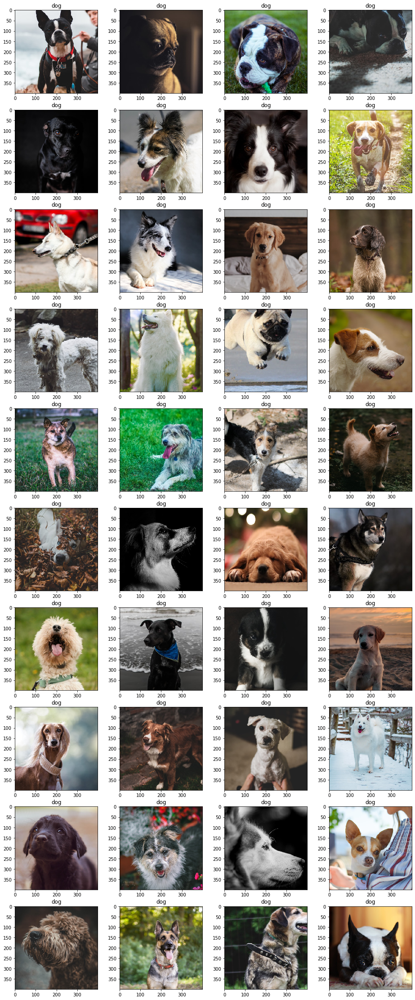

In [0]:
plot_cropped_all(res, 40, random_plot=True)